Text(0.5, 1.0, 'Histogram')

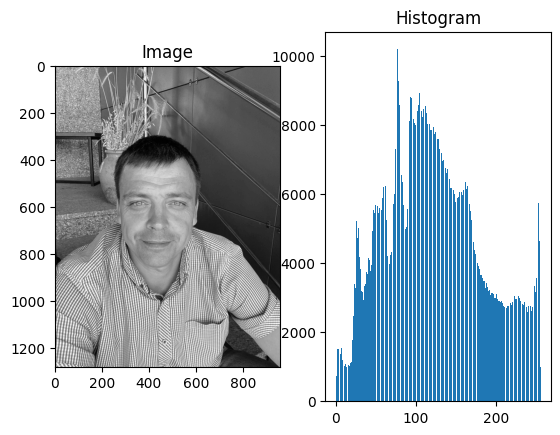

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os
IMAGE_PATH = "test_foto.jpg"
assert os.path.exists(IMAGE_PATH)
image = cv2.imread(IMAGE_PATH) 
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY) 
histogram = cv2.calcHist([gray_image], [0], None, [256], [0, 256]) 
histogram = np.squeeze(histogram) 
histogram_x_range = list(range(len(histogram)))
# plot 
fig, ax = plt.subplots(1, 2) 
ax[0].imshow(gray_image, cmap="gray") 
ax[0].set_title("Image") 
ax[1].bar(x=histogram_x_range, height=histogram) 
ax[1].set_title("Histogram")


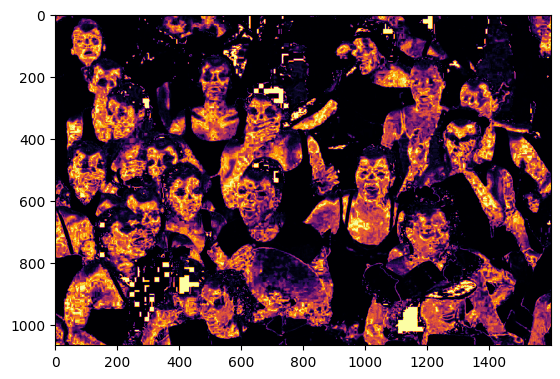

In [2]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import os
TARGET_IMAGE_PATH = "1.jpg"
TRAIN_IMAGE_PATH = "train.jpg"
assert os.path.exists(TARGET_IMAGE_PATH)
assert os.path.exists(TRAIN_IMAGE_PATH)
def read_rgb_from_file(file: str) -> np.ndarray:
    """Reads image and converts it to rgb"""
    image = cv2.imread(file)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    return image
def read_hsv_from_file(file: str) -> np.ndarray:
    """Reads image and converts it to hsv"""
    image = cv2.imread(file)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    return image
train_hsv = read_hsv_from_file(TRAIN_IMAGE_PATH)
train_image_h, train_image_w = train_hsv.shape[:2]
train_image_area = train_image_h * train_image_w
full_image_hsv = read_hsv_from_file(TARGET_IMAGE_PATH)
train_imagehist = cv2.calcHist([train_hsv], [0, 1], None, [180, 256], [0, 180, 0, 256])
backprojection_map = cv2.calcBackProject( [full_image_hsv], [0, 1], train_imagehist, [0, 180, 0, 256], scale=1 )
# Переведем эти значения в вероятности
backprojection_map = backprojection_map.astype(np.float32)
backprojection_map /= train_image_area
plt.imshow(backprojection_map, cmap="inferno")

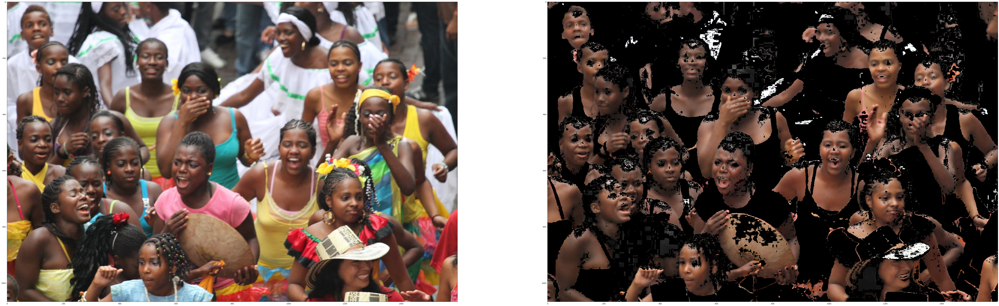

In [3]:
threshold = 0.00009
full_image_rgb = read_rgb_from_file(TARGET_IMAGE_PATH)
mask = backprojection_map > threshold
masked_image = np.copy(full_image_rgb)
masked_image[mask == 0] = [0, 0, 0]
fig, (image1_axes, image2_axes) = plt.subplots(1, 2, figsize=(100, 50))
image1_axes.imshow(full_image_rgb)
image2_axes.imshow(masked_image)

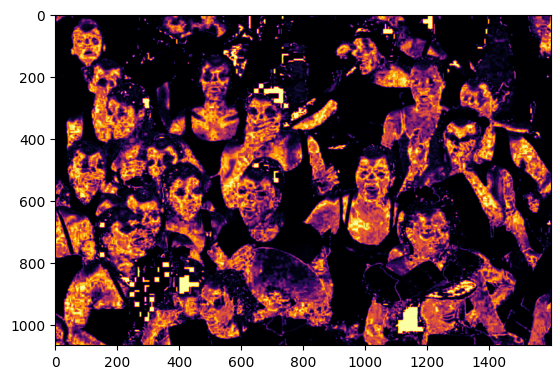

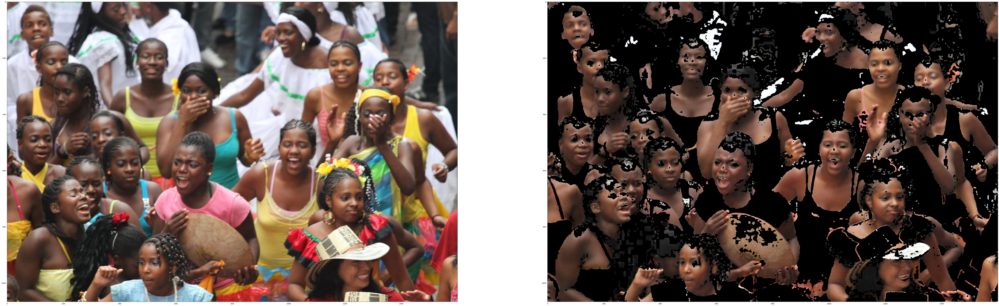

In [5]:
neighborhood_diameter = 5
sigmaColor = 0.35
sigmaSpace = 100
threshold = 0.00009
mask = cv2.bilateralFilter(backprojection_map, neighborhood_diameter, sigmaColor, sigmaSpace)
plt.imshow(mask, cmap="inferno")
plt.show()
mask = mask > threshold
masked_image = np.copy(full_image_rgb)
masked_image[mask == 0] = [0, 0, 0]
fig, (image1_axes, image2_axes) = plt.subplots(1, 2, figsize=(100, 50))
image1_axes.imshow(full_image_rgb)
image2_axes.imshow(masked_image)